# Imports

In [8]:
######## Common ########
import pandas as pd
import os
import copy
from collections import Counter
import ast  # To safely evaluate list-like strings

######## Sound ########
import librosa
from mutagen.oggvorbis import OggVorbis

######## Visualization ########
# Ploting
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
# Geographical Maps
import geopandas as gpd
import contextily as ctx





# Data

### Paths
Path to project and data

In [2]:
# get current directory
project_path = os.getcwd()
train_audio_dir_path = os.path.join(project_path, r"data/train_audio")
soundscapes_audio_dir_path = os.path.join(project_path, r"data/train_soundscapes")

### Read Data

In [3]:
taxonomy = pd.read_csv(os.path.join(project_path, r"data/taxonomy.csv"))
train_df = pd.read_csv(os.path.join(project_path, r"data/train.csv"))

### Taxonomy Dictionaries
Create name dictionary (primary_label - > common_name) and class dictionary (primary_label - > class_name)

In [4]:
# Creating dictionaries
label_to_common = taxonomy.set_index("primary_label")["common_name"].to_dict()
label_to_class = taxonomy.set_index("primary_label")["class_name"].to_dict()

### EDA Data Processing
Working on data to allow insightfull EDA

In [5]:
# Set the path to the directory containing animal folders
base_dir = train_audio_dir_path


""" Count of audio files per animal """
# Count the number of audio files per animal
animal_records_counts_dict = {folder: len(os.listdir(os.path.join(base_dir, folder)))
                 for folder in os.listdir(base_dir)
                 if os.path.isdir(os.path.join(base_dir, folder))}


""" Count of unique animals spicies per class"""
# Count the number of audio files per animal
class_unique_animals_counts_dict = {}
for animal_label, count in animal_records_counts_dict.items():
    # Get class of animal
    animal_class = label_to_class[animal_label]
    
    # Count the number of audio files for each class
    if class_unique_animals_counts_dict.get(animal_class,-1) == -1:
        class_unique_animals_counts_dict[animal_class] = 1
    else:
        class_unique_animals_counts_dict[animal_class] += 1


""" Count of audio files per class (of animals - e.g. mamels,avis) """
# Count the number of audio files per spicies class
class_records_counts_dict = {}
for animal_label, count in animal_records_counts_dict.items():
    # Get class of animal
    animal_class = label_to_class[animal_label]
    
    # Count the number of audio files for each class
    if class_records_counts_dict.get(animal_class,-1) == -1:
        class_records_counts_dict[animal_class] = count
    else:
        class_records_counts_dict[animal_class] += count

# EDA

Setting collors of classes when appear in plots:

In [6]:
# Define colors to match default Matplotlib colors
class_colors = {
    "Aves": "#d62728",      # Red
    "Mammalia": "#ff7f0e",  # Orange
    "Amphibia": "#1f77b4",  # Blue
    "Insecta": "#2ca02c"    # Green
}

## Audio Files Duration Statistics

This code calculates statistics (min duration,max duration,average duration ,count) for audio files from the following groups:
* Labeled Training Data
* Unlabaled Soundscape Data

The is slow, to save time here are the results with duration in seconds:
* Train Audio Stats: {'min_duration': 0.54459375, 'max_duration': 1774.392, 'avg_duration': 35.35247770904827, 'count': 28564}
* Soundscapes Audio Stats: {'min_duration': 60.0, 'max_duration': 60.0, 'avg_duration': 60.0, 'count': 9726}

In [7]:
def get_audio_durations_metadata(directory):
    min_duration = float('inf')
    max_duration = float('-inf')
    total_duration = 0.0
    file_count = 0

    for root, _, files in os.walk(directory):
        for file in files:
            if file.endswith('.ogg'):
                file_path = os.path.join(root, file)
                audio = OggVorbis(file_path)
                duration = audio.info.length  # Duration in seconds

                # Update running statistics
                min_duration = min(min_duration, duration)
                max_duration = max(max_duration, duration)
                total_duration += duration
                file_count += 1

                if file_count%1000==0:
                    print(file_count)


    if file_count > 0:
        avg_duration = total_duration / file_count
    else:
        min_duration = max_duration = avg_duration = None

    return {
        "min_duration": min_duration,
        "max_duration": max_duration,
        "avg_duration": avg_duration,
        "count": file_count
    }



# Process both directories
train_audio_stats = get_audio_durations_metadata(train_audio_dir_path)
soundscapes_audio_stats = get_audio_durations_metadata(soundscapes_audio_dir_path)

# Print results
print("Train Audio Stats:", train_audio_stats)
print("Soundscapes Audio Stats:", soundscapes_audio_stats)

KeyboardInterrupt: 

## Primart Label statistics
This section presents statistics for primary label data:
* The count of unique animals of each class in the dataset
* The count of recordings for each class
* The count of recordings for each animal & statistics

### General dataset statistics

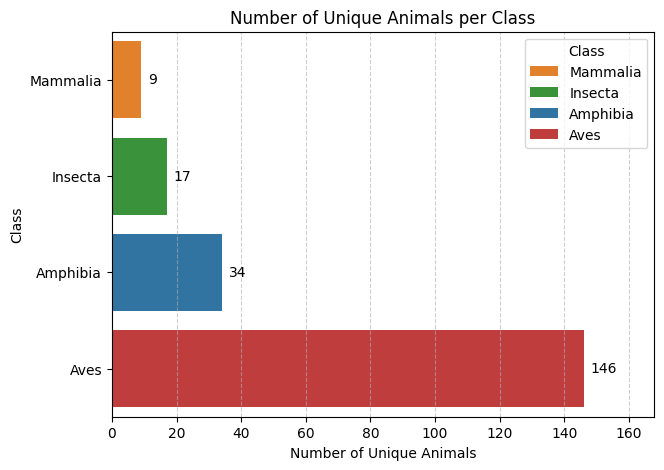

In [64]:
# Convert to DataFrame
df = pd.DataFrame(list(class_unique_animals_counts_dict.items()), columns=["Class", "Count"])
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(7, 5))
ax = sns.barplot(x="Count", y="Class", data=df, hue="Class",  palette=class_colors, legend=True)

# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.15)  # Extend the max value by 15%

plt.xlabel("Number of Unique Animals")
plt.ylabel("Class")
plt.title("Number of Unique Animals per Class")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

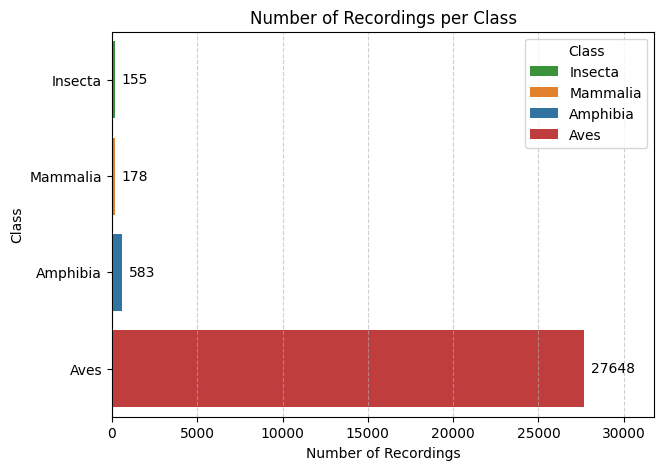

In [65]:
# Convert to DataFrame
df = pd.DataFrame(list(class_records_counts_dict.items()), columns=["Class", "Count"])
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(7, 5))
ax = sns.barplot(x="Count", y="Class", data=df, hue="Class", palette=class_colors,legend=True)

# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.15)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Class")
plt.title("Number of Recordings per Class")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

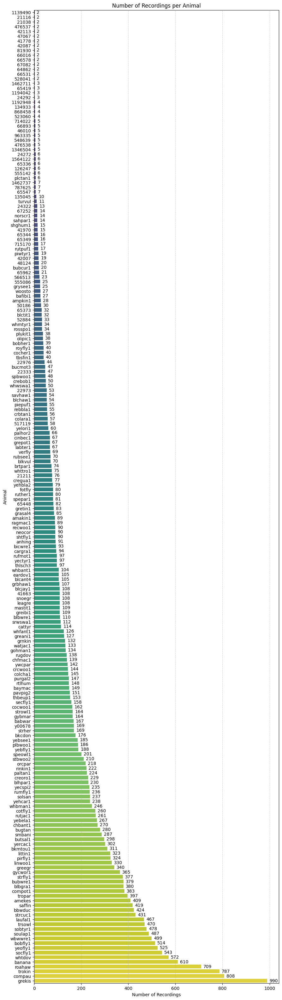

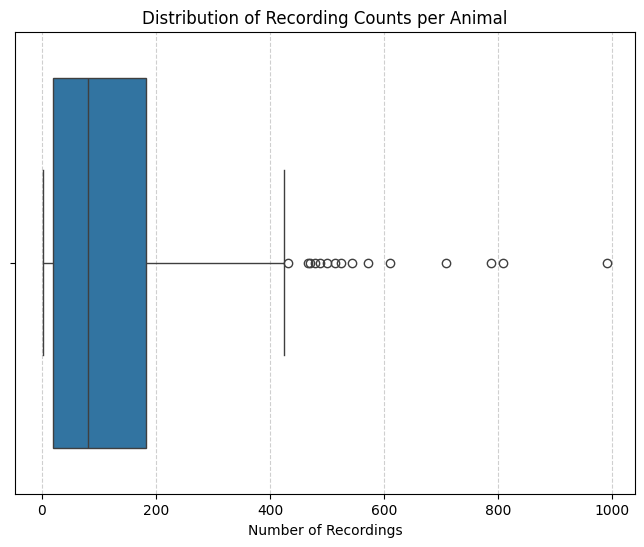

In [66]:
# Convert to DataFrame
df = pd.DataFrame(list(animal_records_counts_dict.items()), columns=["Animal", "Count"])
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(10, 40))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Animal", data=df, hue="Animal", palette="viridis", legend=False)


# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Animal")
plt.title("Number of Recordings per Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()




# Plot box plot for distribution analysis
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Count"])
plt.xlabel("Number of Recordings")
plt.title("Distribution of Recording Counts per Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

### Per Class Statistics
This section presents statistics for primary label data for each of the classes seperatly. 

Classes:
* Aves
* Mammalia
* Amphibia
* Insecta


In [35]:
# Convert to DataFrame
animal_recordings_counts_df = pd.DataFrame(list(animal_records_counts_dict.items()), columns=["Animal", "Count"])

# Add class column (to allow filtering later)
animal_recordings_counts_df["animal_class"] = animal_recordings_counts_df["Animal"].map(label_to_class)

# Create df for each animal class
aves_counts_df = animal_recordings_counts_df[animal_recordings_counts_df["animal_class"] == "Aves"]
mammalia_counts_df = animal_recordings_counts_df[animal_recordings_counts_df["animal_class"] == "Mammalia"]
amphibia_counts_df = animal_recordings_counts_df[animal_recordings_counts_df["animal_class"] == "Amphibia"]
insecta_counts_df = animal_recordings_counts_df[animal_recordings_counts_df["animal_class"] == "Insecta"]

#### Class: Aves

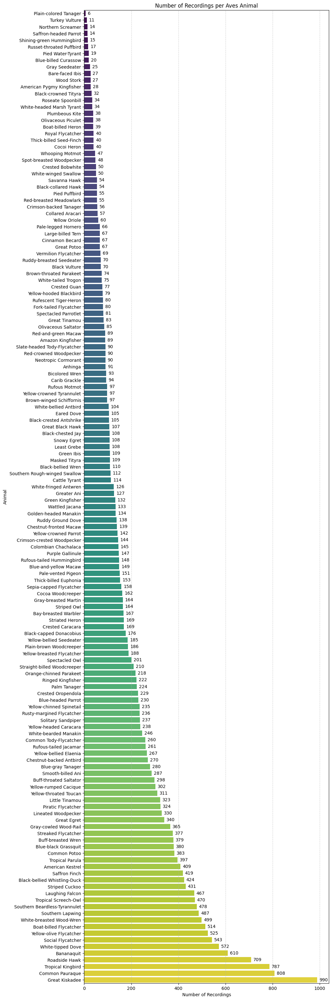

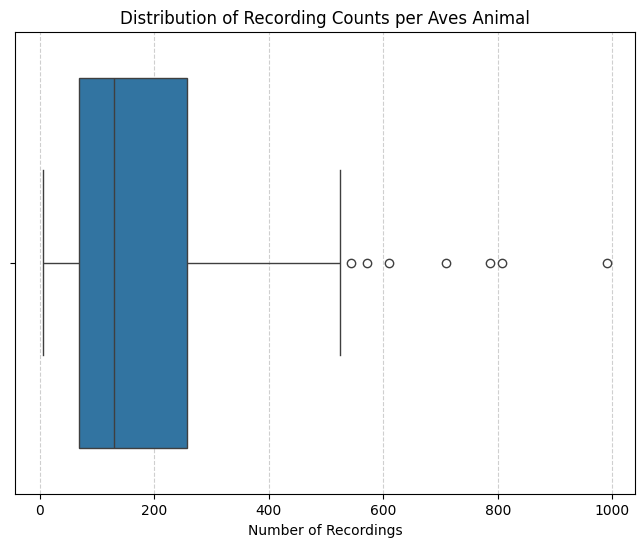

In [37]:
animal_class = "Aves"

# Convert to DataFrame
df = copy.deepcopy(aves_counts_df)
df["Animal"] = df["Animal"].map(label_to_common)
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(10, 40))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Animal", data=df, hue="Animal", palette="viridis", legend=False)


# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Animal")
plt.title(f"Number of Recordings per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()




# Plot box plot for distribution analysis
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Count"])
plt.xlabel("Number of Recordings")
plt.title(f"Distribution of Recording Counts per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

#### Class: Mammalia

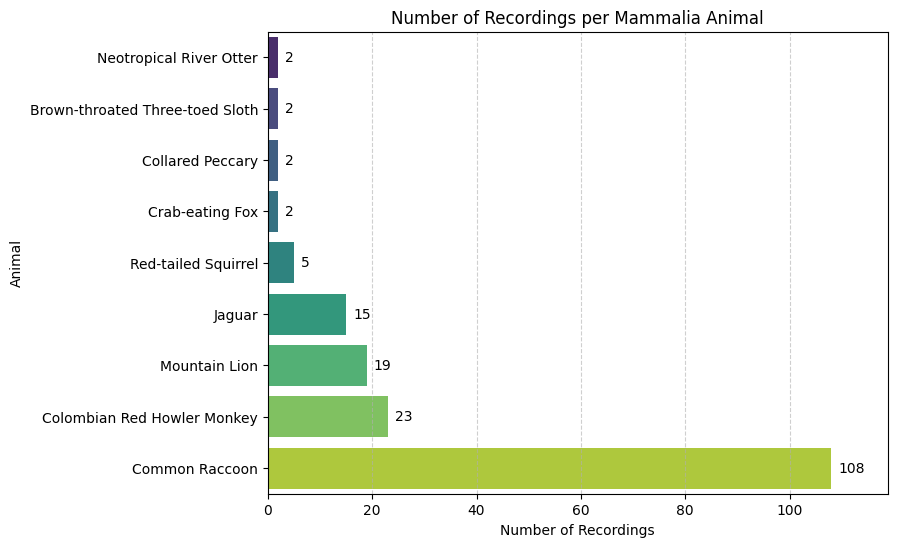

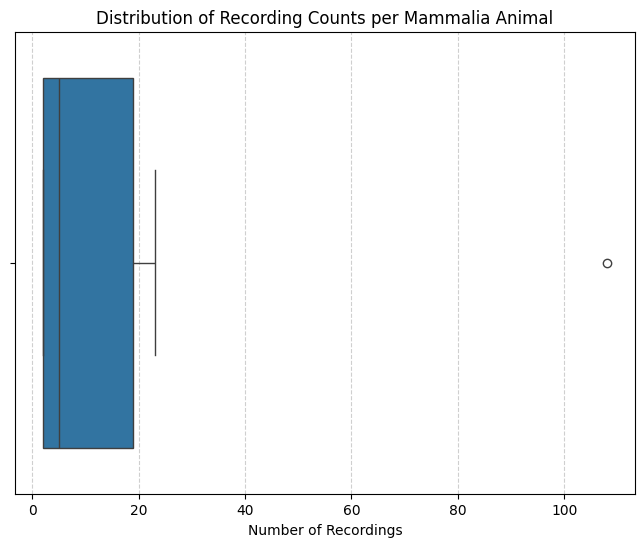

In [36]:
animal_class = "Mammalia"

# Convert to DataFrame
df = copy.deepcopy(mammalia_counts_df)
df["Animal"] = df["Animal"].map(label_to_common)
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(8, 6))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Animal", data=df, hue="Animal", palette="viridis", legend=False)


# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.1)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Animal")
plt.title(f"Number of Recordings per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()




# Plot box plot for distribution analysis
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Count"])
plt.xlabel("Number of Recordings")
plt.title(f"Distribution of Recording Counts per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

#### Class: Amphibia

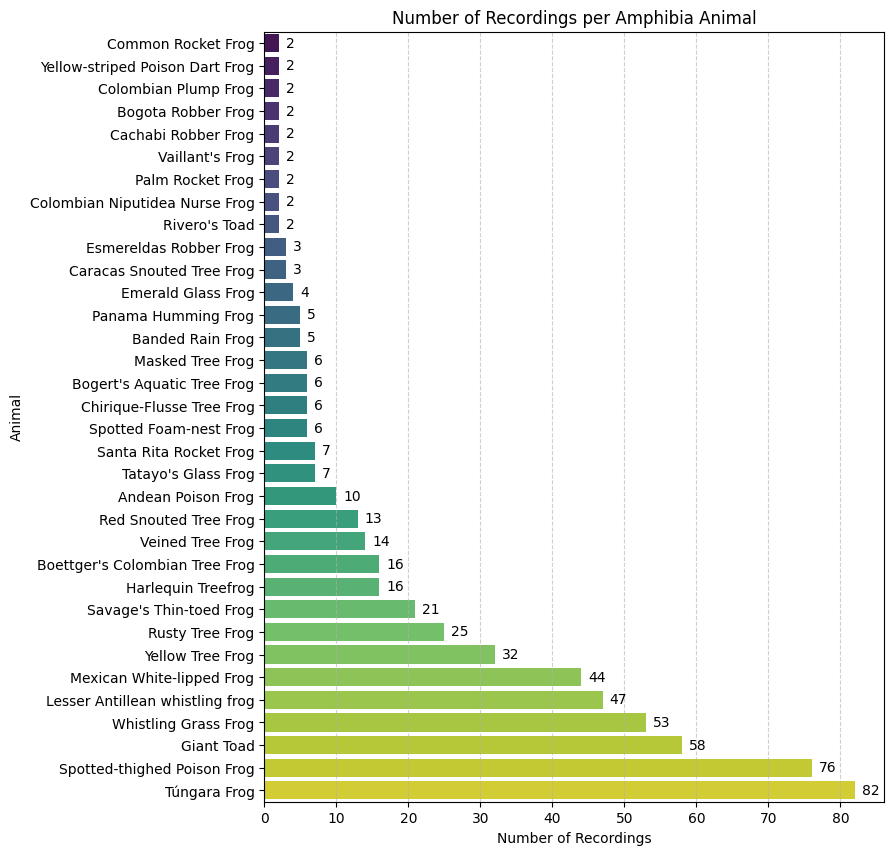

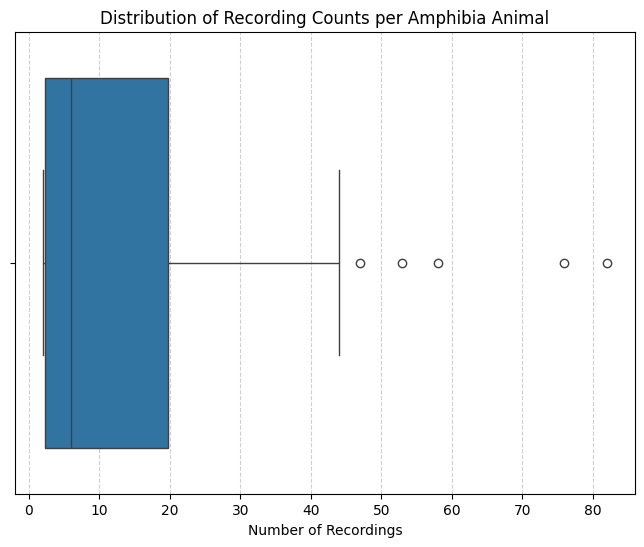

In [38]:
animal_class = "Amphibia"

# Convert to DataFrame
df = copy.deepcopy(amphibia_counts_df)
df["Animal"] = df["Animal"].map(label_to_common)
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(8, 10))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Animal", data=df, hue="Animal", palette="viridis", legend=False)


# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Animal")
plt.title(f"Number of Recordings per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()




# Plot box plot for distribution analysis
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Count"])
plt.xlabel("Number of Recordings")
plt.title(f"Distribution of Recording Counts per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

#### Class: Insecta

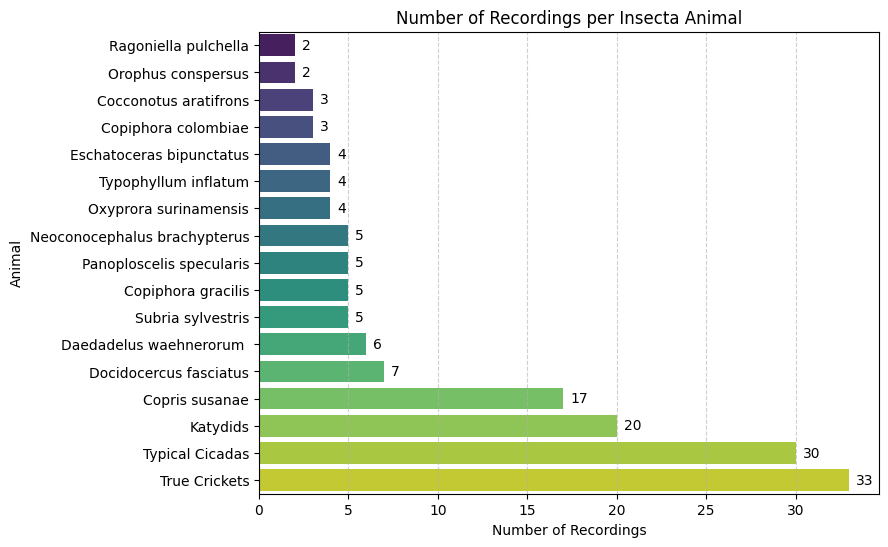

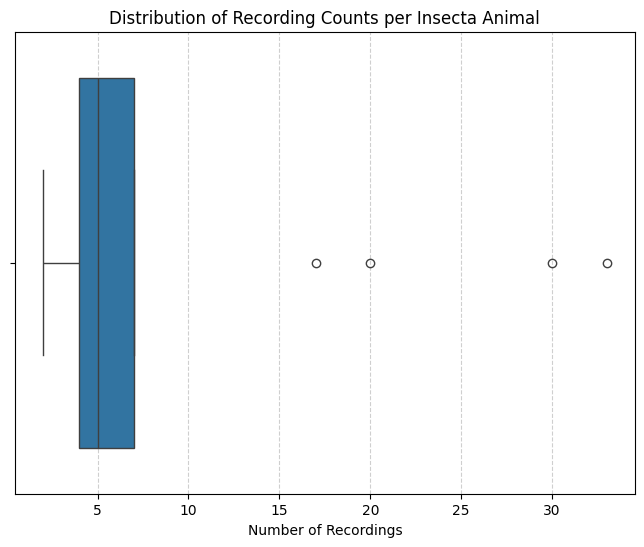

In [39]:
animal_class = "Insecta"

# Convert to DataFrame
df = copy.deepcopy(insecta_counts_df)
df["Animal"] = df["Animal"].map(label_to_common)
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(8, 6))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Animal", data=df, hue="Animal", palette="viridis", legend=False)


# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend the max value by 15%

plt.xlabel("Number of Recordings")
plt.ylabel("Animal")
plt.title(f"Number of Recordings per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()




# Plot box plot for distribution analysis
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Count"])
plt.xlabel("Number of Recordings")
plt.title(f"Distribution of Recording Counts per {animal_class} Animal")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

## Multi Animal Recordings

In [9]:
# Ensure secondary_labels are lists, not strings
train_df["secondary_labels"] = train_df["secondary_labels"].apply(ast.literal_eval)

# Flatten all lists and count occurrences
all_classes = [label_to_class[label] for label in all_labels]  # Remove empty entries
class_counts = Counter(all_classes)


# Flatten all lists and count occurrences
all_labels = [label for sublist in train_df["secondary_labels"] for label in sublist if label]  # Remove empty entries
label_counts = Counter(all_labels)

Next show the number of instances of each class where it appears as a secondary label in a recording <br />
Note: the plot shows that even in secondary labels, the dominant class is the Aves class while other classes due not appear in sufficiant quantity to perform multi label classification.

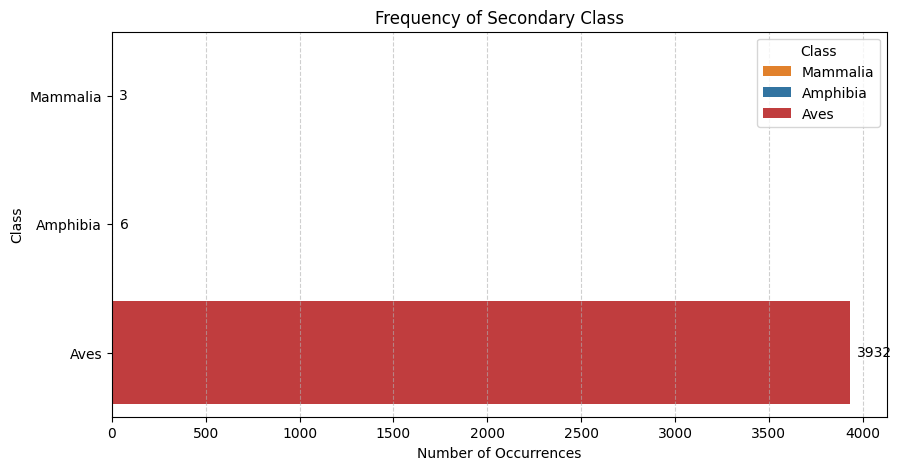

In [10]:

# Convert to DataFrame
df = pd.DataFrame(class_counts.items(), columns=["Class", "Count"])
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(10, max(5, len(df) / 4)))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Class", data=df, hue="Class", palette=class_colors, legend=True)

# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend max value by 5%

plt.xlabel("Number of Occurrences")
plt.ylabel("Class")
plt.title("Frequency of Secondary Class")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

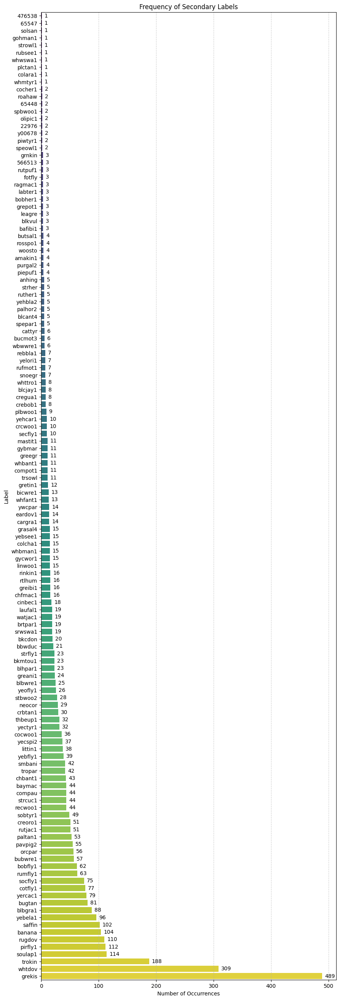

In [11]:
# Convert to DataFrame
df = pd.DataFrame(label_counts.items(), columns=["Label", "Count"])
df.sort_values(by="Count", ascending=True, inplace=True)

# Plot horizontal bar chart
plt.figure(figsize=(10, max(5, len(df) / 4)))  # Adjust height for better visualization
ax = sns.barplot(x="Count", y="Label", data=df, hue="Label", palette="viridis", legend=False)

# Add count numbers to each bar
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=5)

# Adjust x-axis limit for spacing
max_count = df["Count"].max()
plt.xlim(0, max_count * 1.05)  # Extend max value by 5%

plt.xlabel("Number of Occurrences")
plt.ylabel("Label")
plt.title("Frequency of Secondary Labels")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.show()

In [32]:
# Ensure secondary_labels are lists, not strings
# train_df["secondary_labels"] = train_df["secondary_labels"].apply(ast.literal_eval)

# Convert [''] entries to empty lists
train_df["secondary_labels"] = train_df["secondary_labels"].apply(lambda x: [] if x == [""] else x)

# Count rows with and without secondary labels
no_secondary_count = (train_df["secondary_labels"].apply(len) == 0).sum()
with_secondary_count = len(train_df) - no_secondary_count

print(f"Rows without secondary labels: {no_secondary_count}")
print(f"Rows with secondary labels: {with_secondary_count}")

# Count occurrences of secondary labels
all_labels = [label for sublist in train_df["secondary_labels"] for label in sublist if label]
label_counts = Counter(all_labels)
all_classes = [label_to_class[label] for label in all_labels]
class_counts = Counter(all_classes)

# Count primary labels belonging to one class but having secondary labels from another class
cross_class_counts = {}
primary_secondary_combinations = Counter()
for _, row in train_df.iterrows():
    primary_class = label_to_class[row["primary_label"]]
    secondary_classes = set(label_to_class[label] for label in row["secondary_labels"] if label)
    if len(secondary_classes) > 0:
        primary_secondary_combinations[(primary_class, tuple(sorted(secondary_classes)))] += 1
    if secondary_classes != {primary_class}:  # Only if mixed
        cross_class_counts[primary_class] = cross_class_counts.get(primary_class, Counter())
        for sec_class in secondary_classes:
            if sec_class != primary_class:
                cross_class_counts[primary_class][sec_class] += 1


# Print all primary-secondary class combinations
print("\nPrimary-Secondary Class Combinations:")
for (primary_class, secondary_classes), count in primary_secondary_combinations.items():
    print(f"Primary: {primary_class}, Secondary: {list(secondary_classes)}, Count: {count}")


Rows without secondary labels: 25910
Rows with secondary labels: 2654

Primary-Secondary Class Combinations:
Primary: Amphibia, Secondary: ['Amphibia'], Count: 4
Primary: Amphibia, Secondary: ['Aves'], Count: 1
Primary: Aves, Secondary: ['Aves'], Count: 2646
Primary: Aves, Secondary: ['Mammalia'], Count: 3


## Coordinate

Prep

In [19]:
# Rename df for coordinate eda use
coordinate_df = train_df

# Add classes to df
coordinate_df["primary_animal_class"] = coordinate_df["primary_label"].map(label_to_class)

### Inteructive Maps

In [6]:
import pandas as pd
import folium
from folium.plugins import HeatMap

# Load your data
df = train_df

df = df.dropna()

# Create a base map centered at the mean latitude and longitude
m = folium.Map(location=[df["latitude"].mean(), df["longitude"].mean()], zoom_start=6)

# Add heatmap
heat_data = df[['latitude', 'longitude']].values.tolist()
HeatMap(heat_data).add_to(m)

# Save and display map
m.save("heatmap.html")
m

In [9]:
from folium.plugins import MarkerCluster
# Create a base map centered at the mean latitude and longitude
m = folium.Map(location=[df["latitude"].mean(), df["longitude"].mean()], zoom_start=6)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add points to the cluster
for _, row in df.iterrows():
    folium.Marker(location=[row["latitude"], row["longitude"]]).add_to(marker_cluster)

# Save and display map
m.save("marker_map.html")
m

In [10]:
m = folium.Map(location=[df["latitude"].mean(), df["longitude"].mean()], zoom_start=6)

# Add individual circle markers
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=3,  # Size of the dot
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.5
    ).add_to(m)

m.save("circle_marker_map.html")
m

### Fixed Map - Geographical Distribution of Animal Classes

#### General

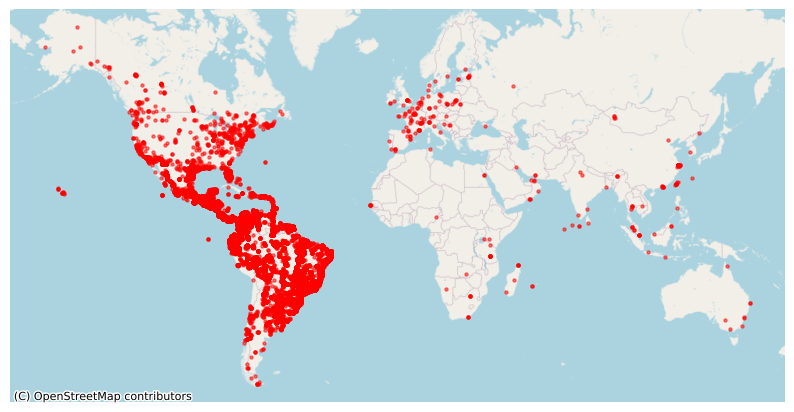

In [24]:
df = coordinate_df

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator (needed for contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot the points
fig, ax = plt.subplots(figsize=(10, 7))
gdf.plot(ax=ax, markersize=5, color="red", alpha=0.5)

# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)
    
# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.show()

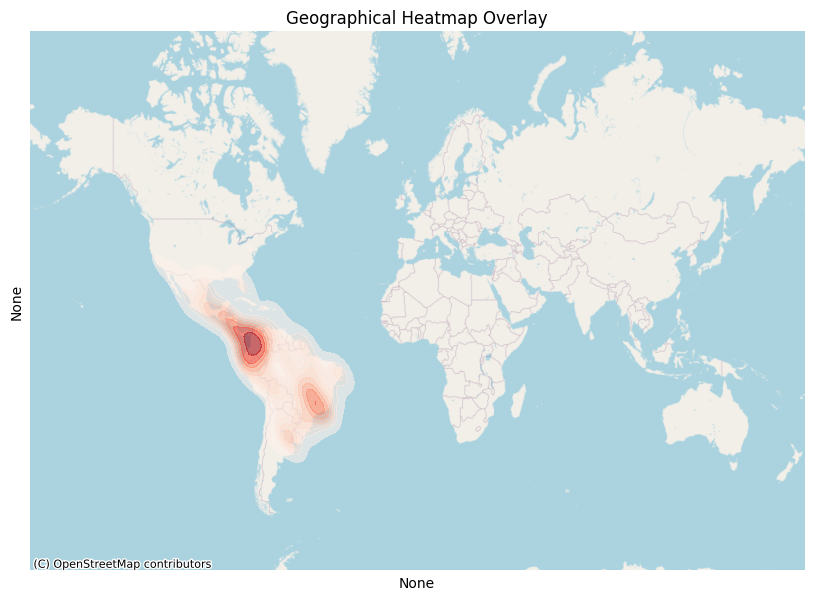

In [51]:


# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator for proper map overlay
gdf = gdf.to_crs(epsg=3857)

# Extract coordinates for plotting
x = gdf.geometry.x
y = gdf.geometry.y

# Create figure and axis
fig, ax = plt.subplots(figsize=(10, 7))

# Plot a density heatmap
sns.kdeplot(x=x, y=y, cmap="Reds", fill=True, alpha=0.6, ax=ax)

# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)
    
# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axis labels
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.title("Geographical Heatmap Overlay")
plt.show()

#### Class: Aves

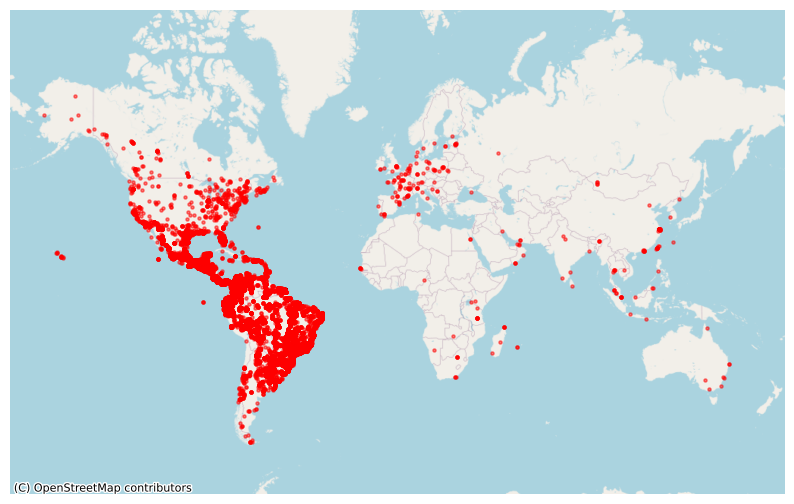

In [50]:
df = coordinate_df[coordinate_df["primary_animal_class"] == "Aves"]

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator (needed for contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot the points
fig, ax = plt.subplots(figsize=(10, 7))
gdf.plot(ax=ax, markersize=5, color="red", alpha=0.5)

# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)
    
# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.show()

#### Class: Mammalia

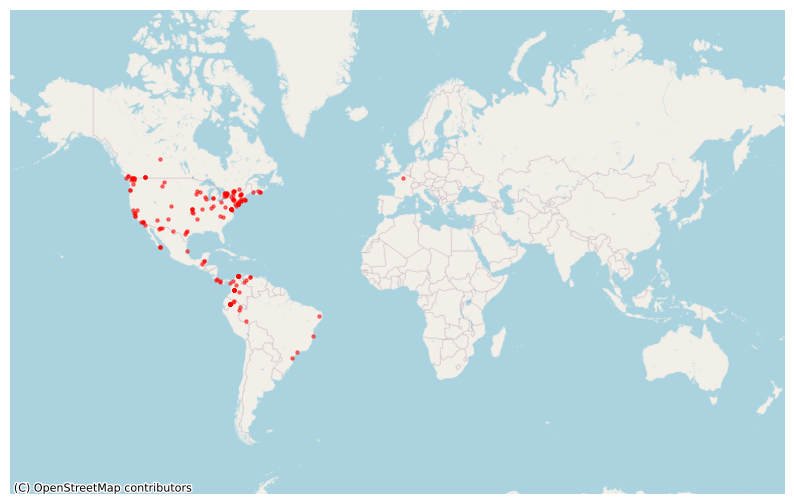

In [49]:
df = coordinate_df[coordinate_df["primary_animal_class"] == "Mammalia"]

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator (needed for contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot the points
fig, ax = plt.subplots(figsize=(10, 7))
gdf.plot(ax=ax, markersize=5, color="red", alpha=0.5)

# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)
    
# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.show()

#### Class: Amphibia

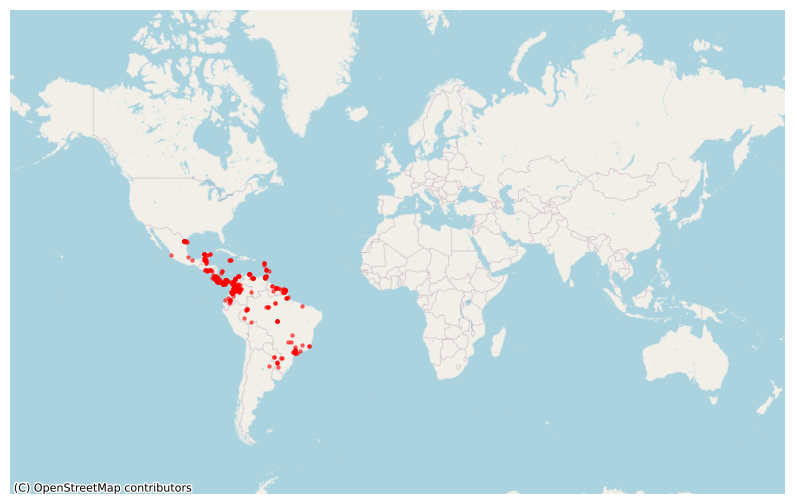

In [48]:
df = coordinate_df[coordinate_df["primary_animal_class"] == "Amphibia"]

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator (needed for contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot the points
fig, ax = plt.subplots(figsize=(10, 7))
gdf.plot(ax=ax, markersize=5, color="red", alpha=0.5)


# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)

# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.show()

#### Class: Insecta

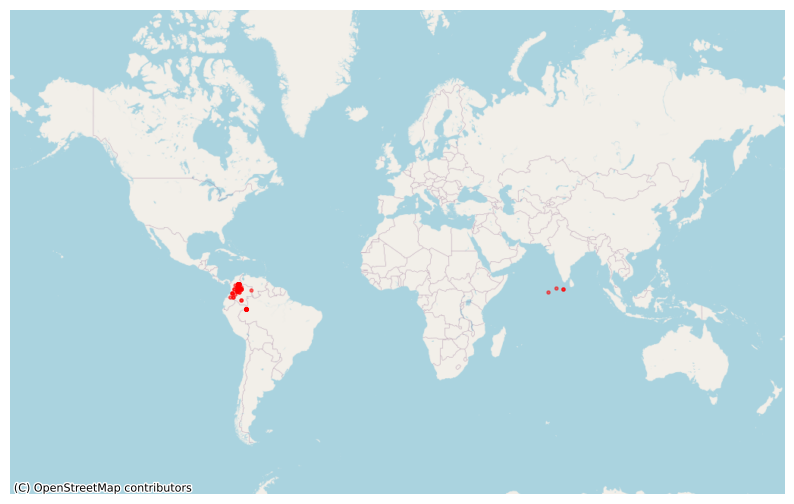

In [47]:
df = coordinate_df[coordinate_df["primary_animal_class"] == "Insecta"]

# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="EPSG:4326")

# Convert to Web Mercator (needed for contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot the points
fig, ax = plt.subplots(figsize=(10, 7))
gdf.plot(ax=ax, markersize=5, color="red", alpha=0.5)

# Set custom zoom extents (e.g., to a larger region)
custom_zoom = True
if custom_zoom:
    minx, miny, maxx, maxy = gdf.total_bounds  # Get bounds of data
    ax.set_xlim(-20000000, 20000000)
    ax.set_ylim(-10000000, 15000000)
else:
    ax.set_xlim(-2e7, 2e7)  # Show the whole world (Web Mercator range)
    ax.set_ylim(-2e7, 2e7)

# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Remove axes
ax.set_xticks([])
ax.set_yticks([])
ax.set_frame_on(False)

plt.show()

## Collection Distribution

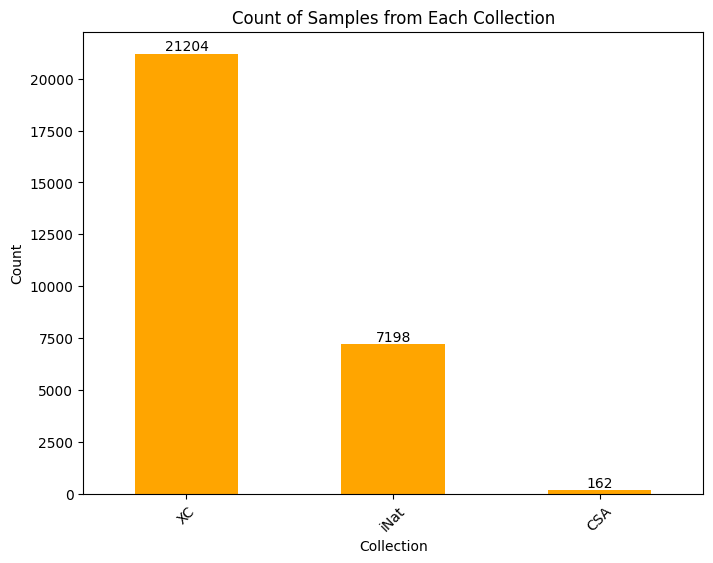

In [98]:
# Count the occurrences of each collection
collection_counts = train_df['collection'].value_counts()

# Plotting the bar chart
plt.figure(figsize=(8, 6))
ax = collection_counts.plot(kind='bar', color='orange')

# Add exact counts at the top of each bar
for i, v in enumerate(collection_counts):
    ax.text(i, v + 0.1, str(v), ha='center', va='bottom', fontsize=10)

plt.title('Count of Samples from Each Collection')
plt.xlabel('Collection')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()